 <h1 style='color:blue'> Analysis of endangering Ground water levels in India </h1> 
                                    
                                    - Ground water ko  bachao( protect)

<h2 style='color:OrangeRed'> Introduction  </h2>

<h2 style='color:OrangeRed'>Data - Description and Sources</h2>

<h3 style='color:green'> Main data sources </h3>

<ul>
    
<li>
<p>Dynamic ground water levels , consumption , recharge volumes are taken from the official data repositories of Indian government <br> <a style='color:blue' href='https://data.gov.in/resources/district-wise-dynamic-ground-water-resources-july-2017-0' >  data.gov.in - Dynamic ground water resources  </a> </p>
</li>
 
<li> 
<p>State-wise Ground water recharge structures and their expenditure for the years 2014-2017 is                            collected from <a style='color:blue' href='https://data.gov.in/resources/stateut-wise-number-ground-water-recharge-structures-2014-15-2017-18-ministry-drinking' > data.gov.in - From Ministry of Drinking  </a> </p>
</li>

<li> 
<p>Ground water resource availability , utilization & Development stages are from <a style='color:blue' href='https://data.gov.in/resources/ground-water-resources-availability-utilization-and-stage-development-march-2011-ministry' > data.gov.in - Ground water ministry  </a> </p>
</li>
</ul>

<hr>

<h3 style='color:green'> Geojson data </h3>

<ul>    
<li>
<p>Json dataset for mapping of each and every district in India is forked from <a style='color:blue' href='https://github.com/geohacker/india/blob/master/district/india_district.geojson' >   Indian districts GeoJson  </a> </p>
</li>
</ul>

<hr>



<h3 style='color:green'> Other supporting data </h3>

<ul>
    
<li>
<p>For calculating the relative values with each state/union territory area, it is scraped from  <a style='color:blue' href='http://statisticstimes.com/geography/area-of-indian-states.php' > Indian States Area(sq km) </a> and integrated with the above data </p>
</li>
 
<li> 
<p>Latitude and Longitude of various States & Union Territories is scraped from <a style='color:blue' href='https://www.distancelatlong.com/country/india'> Indian_States_UT's_LatLong </a> </p>
</li>

<li> 
<p>As the extraction is from various it was a hard time for cleaning and integration of these data.
 </p>
</li>

</ul>

<hr>


<h3 style='color:green'> Analysis </h3>
<p> Region wise data is used to showcase various ground water levels on the map. Individual analysis of ground water usage, restoration , development projects , available water structures will do done for deeply understanding them. KMeans clustering is used for clustering on this whole data and another clustering is done solely on the usage statistics of various states. </p>



<h2 style='color:OrangeRed'> Methodology </h2>

In [77]:
#Importing necessary libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
import seaborn as sns

Reading dynamic groun water resources data as of 2017 in indian districts

In [78]:

df=pd.read_excel('groundwater_2017.xls')

df['Name of State']=[i.title() for i in df['Name of State']]


dic = {'A&N Island':'Andaman and Nicobar Islands', 'Dadra & Nagar Haveli':'Dadar and Nagar Haveli',\
        'Himachal':'Himachal Pradesh', 'J&K':'Jammu and Kashmir','Madhyapradesh':'Madhya Pradesh',\
       'Tamilnadu':'Tamil Nadu','Uttarpradesh':'Uttar Pradesh','Daman':'Daman and Diu','Diu':'Daman and Diu'}

df['Name of State'].replace(to_replace=dic,inplace=True)
    
print('Shape of the dataframe is : ',df.shape)

df.head()

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero
Shape of the dataframe is :  (689, 16)


,S.no.,Name of State,Name of District,Recharge from rainfall During Monsoon Season,Recharge from other sources During Monsoon Season,Recharge from rainfall During Non Monsoon Season,Recharge from other sources During Non Monsoon Season,Total Annual Ground Water Recharge,Total Natural Discharges,Annual Extractable Ground Water Resource,Current Annual Ground Water Extraction For Irrigation,Current Annual Ground Water Extraction For Domestic & Industrial Use,Total Current Annual Ground Water Extraction,Annual GW Allocation for Domestic Use as on 2025,Net Ground Water Availability for future use,Stage of Ground Water Extraction (%)
0,1,Andhra Pradesh,Anantapur,89200.23,46136.12,1013.97,50415.31,186765.62,9338.31,177427.31,142953.85,14884.94,157838.79,21623.75,59410.09,88.96
1,2,Andhra Pradesh,Chittoor,115718.55,32389.60,1204.19,38028.60,187340.94,9367.06,177973.88,95256.50,9597.29,104853.79,13528.83,80858.36,58.92
2,3,Andhra Pradesh,East Godavari,104140.05,95383.56,3714.55,50847.53,254085.69,12704.33,241381.36,41688.32,9418.15,51106.47,4226.85,193656.03,21.17
3,4,Andhra Pradesh,Guntur,52942.86,57011.90,2547.96,18800.39,131303.10,6565.15,124737.95,39174.72,8942.35,48117.07,14159.10,79051.91,38.57
4,5,Andhra Pradesh,Kadapa,93311.68,15869.52,2048.53,11177.61,122407.34,6120.40,116286.94,74888.06,4974.42,79862.47,6110.25,56568.63,68.68


### Grouping by state : For avg_extraction_rate

In [79]:
df_extrate=df.groupby(['Name of State'])['Name of State','Stage of Ground Water Extraction (%)'].mean()
df_extrate.reset_index(inplace=True)
df_extrate.columns=['state','avg_ext_rate']
df_extrate.sort_values(by='avg_ext_rate',ascending=False).reset_index(drop=True)

minval=np.min(df_extrate['avg_ext_rate'])
maxval=np.max(df_extrate['avg_ext_rate'])


# Binning the avg_ext_rate into four categories

df_extrate['cat_avg_ext_rate']=pd.cut(x=df_extrate['avg_ext_rate'], bins=np.linspace(minval,maxval,6),\
                labels=['extremelylow', 'low','medium','high','extremelyhigh'], right=False)

df_extrate.head()

,state,avg_ext_rate,cat_avg_ext_rate
0,Andaman and Nicobar Islands,3.483333,extremelylow
1,Andhra Pradesh,43.921538,low
2,Arunachal Pradesh,0.578182,extremelylow
3,Assam,14.147857,extremelylow
4,Bihar,46.266579,low


### Filtering the DataFrame

Cleaning : Replaced null values of a district(neighborhood) with the state's average value for each column

In [80]:
def filter_the_dataframe(df):
    for i in range(3,len(df.columns)):
        pd.to_numeric(df.iloc[:,i]) 
    df.iloc[:,-1]=df.iloc[:,-1].replace(0,0.001).replace(np.nan,99.9)
    
    for i in range(0,df.shape[0]):
        if df.iloc[i,-1] == 99.9:
            df.iloc[i,-1] = float( df_extrate.loc[ df_extrate['state'] == df.iloc[i,1]]['avg_ext_rate'] )
    return df

In [82]:
df=filter_the_dataframe(df)
print('Filtered dataframe')
df.head(3)

Filtered dataframe


,S.no.,Name of State,Name of District,Recharge from rainfall During Monsoon Season,Recharge from other sources During Monsoon Season,Recharge from rainfall During Non Monsoon Season,Recharge from other sources During Non Monsoon Season,Total Annual Ground Water Recharge,Total Natural Discharges,Annual Extractable Ground Water Resource,Current Annual Ground Water Extraction For Irrigation,Current Annual Ground Water Extraction For Domestic & Industrial Use,Total Current Annual Ground Water Extraction,Annual GW Allocation for Domestic Use as on 2025,Net Ground Water Availability for future use,Stage of Ground Water Extraction (%)
0,1,Andhra Pradesh,Anantapur,89200.23,46136.12,1013.97,50415.31,186765.62,9338.31,177427.31,142953.85,14884.94,157838.79,21623.75,59410.09,88.96
1,2,Andhra Pradesh,Chittoor,115718.55,32389.60,1204.19,38028.60,187340.94,9367.06,177973.88,95256.50,9597.29,104853.79,13528.83,80858.36,58.92
2,3,Andhra Pradesh,East Godavari,104140.05,95383.56,3714.55,50847.53,254085.69,12704.33,241381.36,41688.32,9418.15,51106.47,4226.85,193656.03,21.17


In [83]:
#from sklearn.impute import SimpleImputer
#imp = SimpleImputer(missing_values=np.nan, strategy='mean')

# This could be used , but it wasn't used beacuse it replaces the missing values with the avg of a whole colum , but 
# here we need average of its particular state.

### Plotting the disrict wise water extraction rate

In [85]:
# Getting the GeoJson data for all the districts in india

india_geo = 'india_district.geojson'
with open('india_district.geojson') as f:
    data = json.load(f)

df1=df.copy()
df1=df1.iloc[:,[2,15]] 
df1.columns=['a','b']
df1.head()

,a,b
0,Anantapur,88.96
1,Chittoor,58.92
2,East Godavari,21.17
3,Guntur,38.57
4,Kadapa,68.68


#### A chloropleth map of various water extraction rate of each district

In [105]:
threshold_scale = list( np.linspace(df1['b'].min(),df1['b'].max(),6, dtype=int) )
threshold_scale[-1] = threshold_scale[-1] + 1

india_map = folium.Map(location=[20.5937, 78.9629],zoom_start=5,tiles='Mapbox Bright')


india_map.choropleth(
    geo_data=india_geo,
    data=df1,
    columns=['a','b'],
    #key_on='feature.properties.NAME_1',
    threshold_scale=threshold_scale,
    key_on='feature.properties.NAME_2',
    #fill_color='BuPu',
    fill_color='YlGnBu',
    fill_opacity=0.7, 
    line_opacity='District wise water extraction rate India'
)

# display map
india_map

#### Getting state_wise area in sq_km

In [108]:
url = 'http://statisticstimes.com/geography/area-of-indian-states.php'


# Scraping it and for safe side storing it in a csv file, incase of any modification to the aboe site

try:
    df1 = pd.read_html(url,header=0)[1]
except:
    print('Problem with scraping')
    try:
        df1=pd.read_csv('state_area.csv')
    except:
        print('No csv file for state area is available, scrape it freshly or get an excel file for it')
    

#df1.to_csv('state_area.csv',header=True)    
    
df1=df1.drop(df1.index[-1])

df_state_area = df1.copy()[['State','Area (Sq Km)']]


# By manually checking found of that many names aren't matching , so doing this for proper data integration

dic1={'Jammu & Kashmir': 'Jammu and Kashmir','A. & N. Islands':'Andaman And Nicobar Islands','D.& N. Haveli':\
  'Dadar and Nagar Haveli', 'Daman & Diu'  :'Daman And Diu'}



df_state_area['State'] = df1['State'].replace(to_replace=dic1)

df_state_area = df_state_area.sort_values(by='State').reset_index(drop=True)

df_state_area.columns=['State','Area_sqkm']


df_state_area.head()

,State,Area_sqkm
0,Andaman And Nicobar Islands,8249
1,Andhra Pradesh,162970
2,Arunachal Pradesh,83743
3,Assam,78438
4,Bihar,94163


In [109]:
df_extrate=df.groupby(['Name of State'])['Name of State','Stage of Ground Water Extraction (%)'].mean()
df_extrate.reset_index(inplace=True)
df_extrate.columns=['state','avg_ext_rate']
df_extrate.sort_values(by='avg_ext_rate',ascending=False).reset_index(drop=True)

minval=np.min(df_extrate['avg_ext_rate'])
maxval=np.max(df_extrate['avg_ext_rate'])

# Getting annual groun water extraction rate
df_extrate['cat_avg_ext_rate']=pd.cut(x=df_extrate['avg_ext_rate'], bins=np.linspace(minval,maxval,6), labels=['extremelylow', 'low','medium','high','extremelyhigh'], right=False)

# Getting Annaul ground water recharge of each stat/ut
df_extrate['annual_gwr']= list(df.groupby(['Name of State'])['Total Annual Ground Water Recharge'].sum().round(3))


#  Getting per_sq_km annual ground water recharge in each state/ut
df_extrate['annual_gwr_sqkm'] = df_extrate['annual_gwr'] / df_state_area['Area_sqkm']


df_extrate.head()

,state,avg_ext_rate,cat_avg_ext_rate,annual_gwr,annual_gwr_sqkm
0,Andaman and Nicobar Islands,3.483333,extremelylow,36841.83,4.466218
1,Andhra Pradesh,43.921538,low,2121785.20,13.019483
2,Arunachal Pradesh,0.578182,extremelylow,302499.86,3.612241
3,Assam,14.147857,extremelylow,2867207.67,36.553809
4,Bihar,46.266579,low,3141397.82,33.361276


#### Getting no of ponds,traditional water bodies constructed and states expenditure on them from 2014  2017

In [110]:
df2=pd.read_excel('gw_spendings.xls')

df2=df2.replace(to_replace={'Andaman and Nicobar':'Andaman and Nicobar Islands'})
df2['ponds_waterbodies_14to18']=df2.iloc[:,[2,4,6,8]].sum(axis=1)
df2['exp_14to18_lakhs']=df2.iloc[:,[3,5,7,9]].sum(axis=1)

df_water=df2.iloc[:-1,[1,-2,-1]]

no_data_list = [['Chandigarh',0,0] ,['Dadar and Nagar Haveli',0,0], ['Delhi',0,0], ['Goa',0,0],  ['Lakshadweep',0,0] ]
df_temp = pd.DataFrame( no_data_list, columns=list(df_water.columns))
df_water = df_water.append(df_temp,ignore_index=True)



df_water.sort_values(by='State/UT',inplace=True)

df_water = df_water.reset_index(drop=True)

df_water.head()

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero


,State/UT,ponds_waterbodies_14to18,exp_14to18_lakhs
0,Andaman and Nicobar Islands,0,0.00
1,Andhra Pradesh,0,0.00
2,Arunachal Pradesh,0,0.00
3,Assam,15,4.04
4,Bihar,0,0.00


#### The above table is obtained by grouping together individual values for each year from the given csv file

##### Visualizing the Statewise_Ground_water_development_Stage

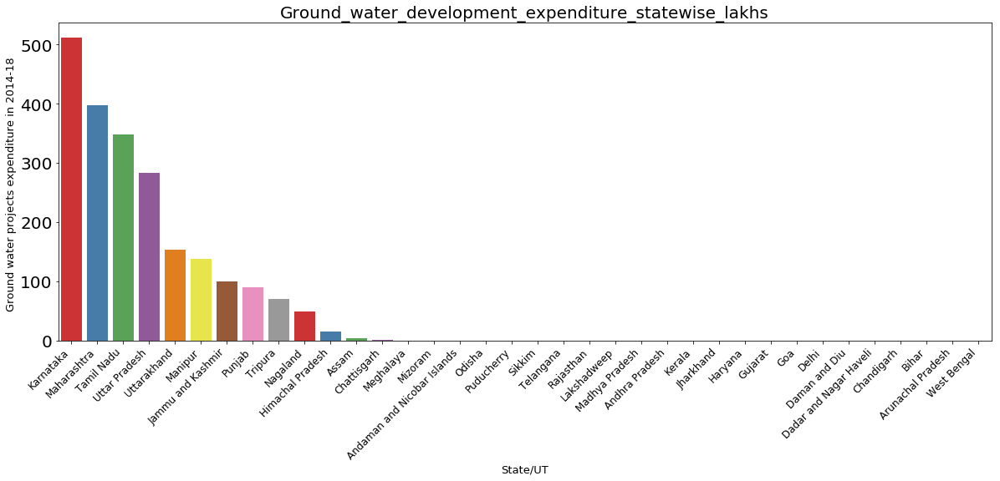

In [137]:
df_temp = df_water.copy()

df_temp =df_temp.sort_values(by='exp_14to18_lakhs',ascending=False)

plt.figure(figsize=(20,7))

ch = sns.barplot(df_temp['State/UT'],df_temp['exp_14to18_lakhs'],palette='Set1')

l=ch.get_xticklabels()

ch.set_xticklabels(l,rotation=45, horizontalalignment='right',fontweight='light',fontsize=12)

ch.set_xlabel('State/UT',fontsize=13)
ch.set_ylabel('Ground water projects expenditure in 2014-18 ',fontsize=13)

ch.set_title('Ground_water_development_expenditure_statewise_lakhs',fontsize=20)

plt.show()

In [112]:
df_extrate = pd.merge(left=df_extrate, right=df_water,left_on='state',right_on='State/UT')

df_extrate.drop(['State/UT'],axis=1,inplace=True)

df_extrate.head()

,state,avg_ext_rate,cat_avg_ext_rate,annual_gwr,annual_gwr_sqkm,ponds_waterbodies_14to18,exp_14to18_lakhs
0,Andaman and Nicobar Islands,3.483333,extremelylow,36841.83,4.466218,0,0.00
1,Andhra Pradesh,43.921538,low,2121785.20,13.019483,0,0.00
2,Arunachal Pradesh,0.578182,extremelylow,302499.86,3.612241,0,0.00
3,Assam,14.147857,extremelylow,2867207.67,36.553809,15,4.04
4,Bihar,46.266579,low,3141397.82,33.361276,0,0.00


#### Getting Annual irrigation , household & industrial usage of ground water for each state

In [113]:
df3 = df.iloc[:,[1,10,11]].groupby(['Name of State']).sum().reset_index()

df3.columns=['Name of State','annual_irrigation','annual_house_industries']

df3.head()

,Name of State,annual_irrigation,annual_house_industries
0,Andaman and Nicobar Islands,14.78,893.39
1,Andhra Pradesh,785040.41,104662.80
2,Arunachal Pradesh,0.00,744.50
3,Assam,197470.56,75338.19
4,Bihar,1077916.29,248502.09


In [114]:
df_extrate = pd.merge(left=df_extrate, right=df3,left_on='state',right_on='Name of State')

df_extrate.drop(['Name of State'],axis=1,inplace=True)

df_extrate.head()

,state,avg_ext_rate,cat_avg_ext_rate,annual_gwr,annual_gwr_sqkm,ponds_waterbodies_14to18,exp_14to18_lakhs,annual_irrigation,annual_house_industries
0,Andaman and Nicobar Islands,3.483333,extremelylow,36841.83,4.466218,0,0.00,14.78,893.39
1,Andhra Pradesh,43.921538,low,2121785.20,13.019483,0,0.00,785040.41,104662.80
2,Arunachal Pradesh,0.578182,extremelylow,302499.86,3.612241,0,0.00,0.00,744.50
3,Assam,14.147857,extremelylow,2867207.67,36.553809,15,4.04,197470.56,75338.19
4,Bihar,46.266579,low,3141397.82,33.361276,0,0.00,1077916.29,248502.09


## K.Means Clustering

### Let's classify the states based on their similarities of extraction and restoration etc

In [115]:
df_final = df_extrate.drop(['cat_avg_ext_rate'],axis=1)

df_final.head()

,state,avg_ext_rate,annual_gwr,annual_gwr_sqkm,ponds_waterbodies_14to18,exp_14to18_lakhs,annual_irrigation,annual_house_industries
0,Andaman and Nicobar Islands,3.483333,36841.83,4.466218,0,0.00,14.78,893.39
1,Andhra Pradesh,43.921538,2121785.20,13.019483,0,0.00,785040.41,104662.80
2,Arunachal Pradesh,0.578182,302499.86,3.612241,0,0.00,0.00,744.50
3,Assam,14.147857,2867207.67,36.553809,15,4.04,197470.56,75338.19
4,Bihar,46.266579,3141397.82,33.361276,0,0.00,1077916.29,248502.09


In [116]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.pipeline import Pipeline

X = df_final.iloc[:,1:]

cluster_dataset = StandardScaler().fit_transform(X)

num_clusters = 5

k_means = KMeans(init="k-means++", n_clusters=num_clusters, n_init=12)
k_means.fit(cluster_dataset)
kmeans_labels = k_means.labels_

print(kmeans_labels)

[2 0 2 0 0 3 2 2 2 3 2 0 0 2 2 2 1 2 3 0 1 2 2 2 2 0 3 0 0 3 1 0 2 4 2 0]


## Getting the latitude , longitude values of states and UT's of India

In [117]:
url = 'https://www.distancelatlong.com/country/india'

try:
    df1 = pd.read_html(url,header=0)[2]
except:
    print('Problem with scraping')
    try:
        df1=pd.read_csv('state_latlong.csv')
    except:
        print('No csv file for state area is available, scrape it freshly or get an excel file for it')
    


df1['States']=[ i.split('(')[0].strip() for i in  list(df1['States']) ]


# By manually checking found of that many names aren't matching , so doing this for proper data integration

dic4={'Andaman And Nicobar':'Andaman and Nicobar Islands','Dadra And Nagar Haveli':'Dadar and Nagar Haveli',\
 'Jammu And Kashmir':'Jammu and Kashmir','Uttaranchal':'Uttarkhand','Orissa':'Odisha',}

df1 = df1.replace(to_replace=dic4)

df1.iloc[1,:]=['Andhra Pradesh',15.9129, 79.7400]

missing_loc =[['Gujarat',22.25,71.19],['Daman and Diu',20.4283, 72.8397],['Telangana',18.1124, 79.0193]]

df_temp = pd.DataFrame( missing_loc , columns=list(df1.columns))
df1 = df1.append(df_temp,ignore_index=True)

df1=df1.sort_values(by='States')

df1=df1.reset_index(drop=True)

#  df1.to_csv('state_latlong.csv',header=True)   

df1.head()

,States,Latitude,Longitude
0,Andaman and Nicobar Islands,11.667026,92.735983
1,Andhra Pradesh,15.912900,79.740000
2,Arunachal Pradesh,27.100399,93.616601
3,Assam,26.749981,94.216667
4,Bihar,25.785414,87.479973


<h4> Plotting the clusters on mapClustering it on all attributes, it clusters the states/U.T's with similar ground water recharge , consumption and spendings on gw_restoration projects etc </h4>

In [120]:


india_map2 = folium.Map(location=[20.5937, 78.9629],zoom_start=5,tiles='Stamen Toner')

#nellore_map = folium.Map(location=[14.4426, 79.9865],zoom_start=10,tiles='Stamen Terrain' )

incidents=folium.map.FeatureGroup()


for lat,lng in zip(df1.Latitude,df1.Longitude):
    incidents.add_child(
            folium.features.CircleMarker(
            [lat,lng],
            color='yellow',
            fill=True ,  
            fill_color='green',
            fill_opacity=0.75,
            radius=5                       
            )
     
        )
lats=list(df1.Latitude)    
longs=list(df1.Longitude)    
labels=list(df1.States)

colors=['red','green','blue','pink','orange']

i=0


# Adding markers for each state & UT

for lat,lng,label in zip(lats,longs,labels):
    folium.Marker([lat,lng],popup=label,icon=folium.Icon(color=colors[int(kmeans_labels[i])],prefix='fa',icon='tint')).add_to(india_map2)
    i+=1



india_map2.add_child(incidents)



The above states/ut's are clustering considering all the factors into consideration such as ground water 
extraction rate, restoration rate, development levels.

<p style='color:green'>In the above map, the points belong to same cluster indicate that, similar levels:</p>

    * Extraction *Restoration * Development stages of Ground water.
* This can be understood by 'Seven sisters of India' belonging to almost same cluster
* Andhra Pradesh and Telangana which are recently bifurcated came under the same cluster.

<p><b>  By this we can say that the above clustering worked well.</b></p>

###  Clustering  States/U.T's based on various types of GW consumption rates

In [123]:
# df_gw_usage = df_final.iloc[:,[0,1,6,7]]

df_gw_usage = df_final.iloc[:,[0,1]]

df_gw_usage.head()

,state,avg_ext_rate
0,Andaman and Nicobar Islands,3.483333
1,Andhra Pradesh,43.921538
2,Arunachal Pradesh,0.578182
3,Assam,14.147857
4,Bihar,46.266579


In [124]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.pipeline import Pipeline

X = df_gw_usage.iloc[:,1:]

cluster_dataset = StandardScaler().fit_transform(X)

num_clusters = 4

k_means = KMeans(init="k-means++", n_clusters=num_clusters, n_init=20)
k_means.fit(cluster_dataset)
kmeans_labels = k_means.labels_

print('Cluster of each based on water consumption : ',kmeans_labels)

Cluster of each based on water consumption :  [3 1 3 3 1 2 1 1 2 0 1 2 0 0 1 1 2 1 2 1 1 3 3 3 3 1 2 0 0 3 2 2 3 2 1 1]


In [125]:


india_map2 = folium.Map(location=[20.5937, 78.9629],zoom_start=5,tiles='Stamen Toner')

#nellore_map = folium.Map(location=[14.4426, 79.9865],zoom_start=10,tiles='Stamen Terrain' )

incidents=folium.map.FeatureGroup()


for lat,lng in zip(df1.Latitude,df1.Longitude):
    incidents.add_child(
            folium.features.CircleMarker(
            [lat,lng],
            color='yellow',
            fill=True ,  
            fill_color='green',
            fill_opacity=0.75,
            radius=5                       
            )
     
        )
lats=list(df1.Latitude)    
longs=list(df1.Longitude)    
labels=list(df1.States)

colors=['red','green','blue','pink','orange']

i=0

for lat,lng,label in zip(lats,longs,labels):
    folium.Marker([lat,lng],popup=label,icon=folium.Icon(color=colors[int(kmeans_labels[i])],prefix='fa',icon='tint')).add_to(india_map2)
    i+=1



india_map2.add_child(incidents)



### Ground Water Development rate and Usage Stats 

In [126]:
df_usage=pd.read_excel('gw_dev_usage_projects.xls')


df_usage.drop([30,37,38],inplace=True)

df_usage.fillna(0,inplace=True)

df_usage.sort_values(by='Stage of Ground Water Development (%)',ascending=False,inplace=True)

df_usage= df_usage.reset_index(drop=True)

df_usage.head()                

WARNING *** OLE2 inconsistency: SSCS size is 0 but SSAT size is non-zero


,Sl.No,State/Union Territories,Annual Replenishable Ground Water Resource,Natural Discharge during non-monsoon season,Net Annual Ground Water Availability,Annual Ground Water Draft - Irrigation,Annual Ground Water Draft - Domestic and industrial uses,Annual Ground Water Draft - Total,Stage of Ground Water Development (%)
0,22,Punjab,25.910,2.520,23.390,34.050,0.770,34.810,149.0
1,23,Rajasthan,12.510,1.260,11.260,13.790,1.920,15.710,140.0
2,9,Haryana,11.360,1.060,10.300,13.320,0.600,13.920,135.0
3,6,Delhi,0.340,0.030,0.310,0.140,0.250,0.390,127.0
4,6,Puducherry,0.193,0.019,0.174,0.124,0.029,0.153,88.0


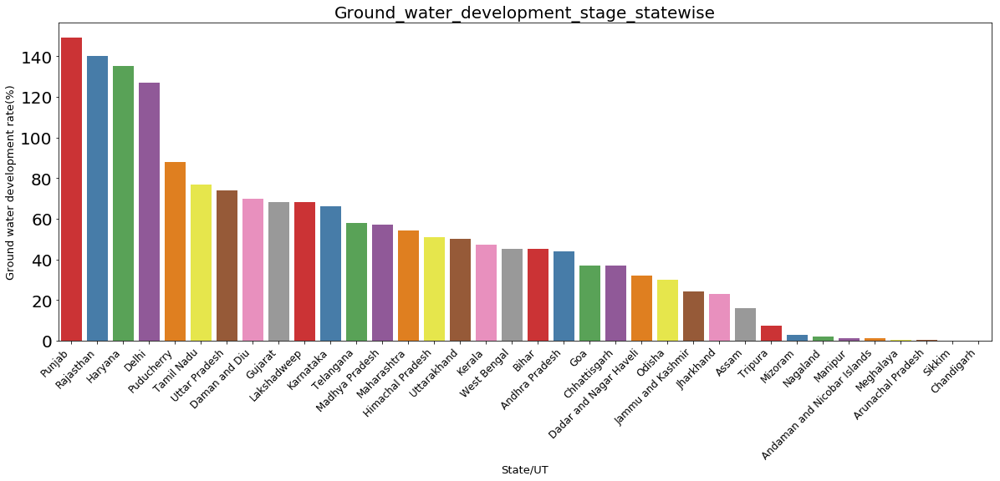

In [127]:
plt.figure(figsize=(20,7))

ch = sns.barplot(df_usage['State/Union Territories'],df_usage['Stage of Ground Water Development (%)'],palette='Set1')

l=ch.get_xticklabels()

ch.set_xticklabels(l,rotation=45, horizontalalignment='right',fontweight='light',fontsize=12)

ch.set_xlabel('State/UT',fontsize=13)
ch.set_ylabel('Ground water development rate(%)',fontsize=13)

ch.set_title('Ground_water_development_stage_statewise',fontsize=20)

plt.show()

By observing this government or volunteer organization can concentrate on conducting awareness campaingns and
ground water restoration projects so as to save 'Our Mother Earth' and provide a better world for future generations

### Lets check the ground water restoration per sq.km so as to get the areas of interest for improving  the low level zones

In [128]:
# Annual ground water extraction rate per sq.km  in  each state/UT
df_annual_gwr_sqkm =df_final.copy()

df_annual_gwr_sqkm = df_annual_gwr_sqkm.iloc[:,[0,3]]

df_annual_gwr_sqkm.sort_values(by='annual_gwr_sqkm',ascending=True,inplace=True)

df_annual_gwr_sqkm.set_index('state',inplace=True)

df_annual_gwr_sqkm.head()

,annual_gwr_sqkm
state,
Himachal Pradesh,0.908462
Mizoram,1.009476
Jammu and Kashmir,1.300458
Manipur,1.925539
Arunachal Pradesh,3.612241


Text(0.5,1,'Annual_avg_ground_water_restoration_sqkm')

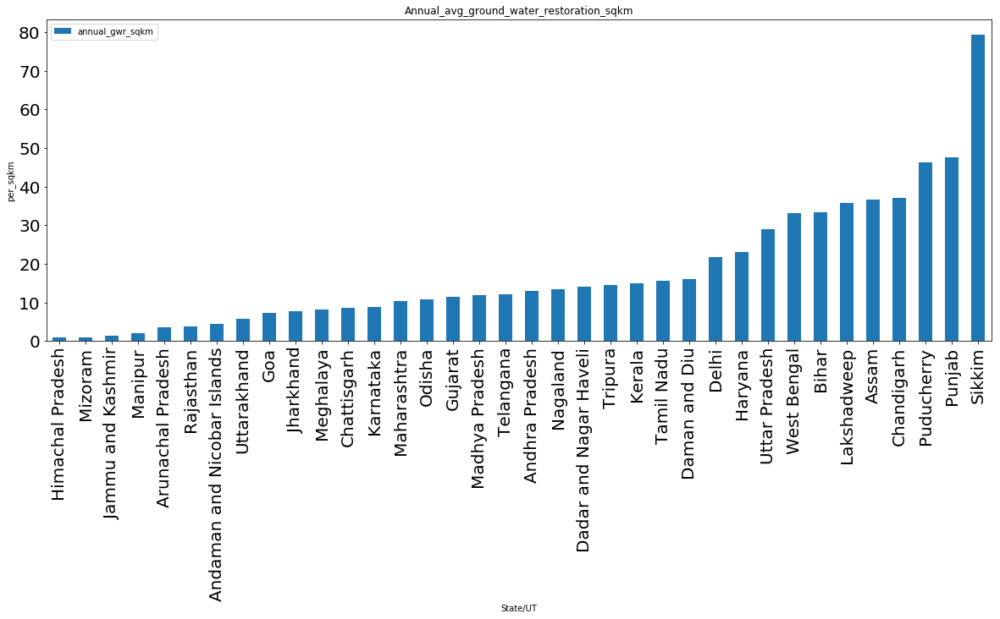

In [138]:
df_annual_gwr_sqkm.plot(kind='bar', figsize=(20, 7), rot=90) 



plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20) 

plt.xlabel('State/UT')

plt.ylabel('per_sqkm')

plt.title('Annual_avg_ground_water_restoration_sqkm')

#### By understanding the above we can observe the low level zones and  necessary steps can be taken to improve them.

## Industrial and House hold usage of Ground water

In [130]:


#df_temp2=df_usage.copy()
#df_temp2=df_temp2.sort_values(by='Annual Ground Water Draft - Domestic and industrial uses',ascending=False)
#ch = sns.barplot(df_temp2['State/Union Territories'],df_temp2['Annual Ground Water Draft - Domestic and industrial uses'],palette='Set1')

df_temp2=df.groupby(['Name of State'])['Name of State','Current Annual Ground Water Extraction For Domestic & Industrial Use'].sum()

df_temp2=df_temp2.reset_index()

df_temp2['dom_ind_usage_sqkm']=df_temp2.iloc[:,1] /df_state_area['Area_sqkm']

df_temp2.head()


,Name of State,Current Annual Ground Water Extraction For Domestic & Industrial Use,dom_ind_usage_sqkm
0,Andaman and Nicobar Islands,893.39,0.108303
1,Andhra Pradesh,104662.80,0.642221
2,Arunachal Pradesh,744.50,0.008890
3,Assam,75338.19,0.960481
4,Bihar,248502.09,2.639063


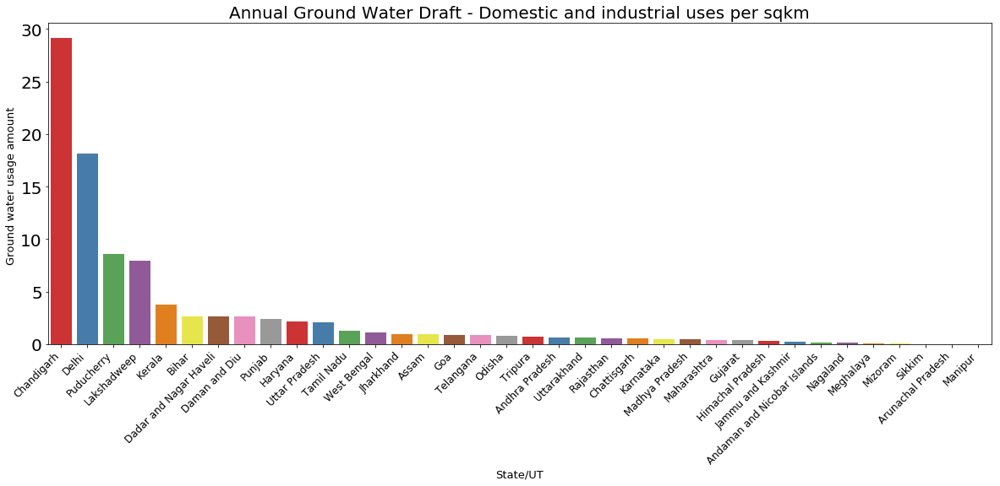

In [131]:
plt.figure(figsize=(20,7))

df_temp2=df_temp2.sort_values(by='dom_ind_usage_sqkm',ascending=False)

ch = sns.barplot(df_temp2['Name of State'],df_temp2['dom_ind_usage_sqkm'],palette='Set1')

l=ch.get_xticklabels()

ch.set_xticklabels(l,rotation=45, horizontalalignment='right',fontweight='light',fontsize=12)

ch.set_xlabel('State/UT',fontsize=13)
ch.set_ylabel('Ground water usage amount ',fontsize=13)

ch.set_title('Annual Ground Water Draft - Domestic and industrial uses per sqkm',fontsize=20)

plt.show()

We can observe the more/households or industries are using up more water in UT's like chandigarh ,delhi , puducherry have
to be monitorred carefully and regulation should be made on further establishment of ground-water dependent industries 

States like Kerala, Bihar , Punjab should be taken care of ground water levels

## Ground Water usage for Irrigation purposes

In [132]:

df_temp2=df.groupby(['Name of State'])['Name of State','Current Annual Ground Water Extraction For Irrigation'].sum()

df_temp2=df_temp2.reset_index()

df_temp2['irrigation_usage_sqkm']=df_temp2.iloc[:,1] /df_state_area['Area_sqkm']

df_temp2.head()


,Name of State,Current Annual Ground Water Extraction For Irrigation,irrigation_usage_sqkm
0,Andaman and Nicobar Islands,14.78,0.001792
1,Andhra Pradesh,785040.41,4.817085
2,Arunachal Pradesh,0.00,0.000000
3,Assam,197470.56,2.517537
4,Bihar,1077916.29,11.447344


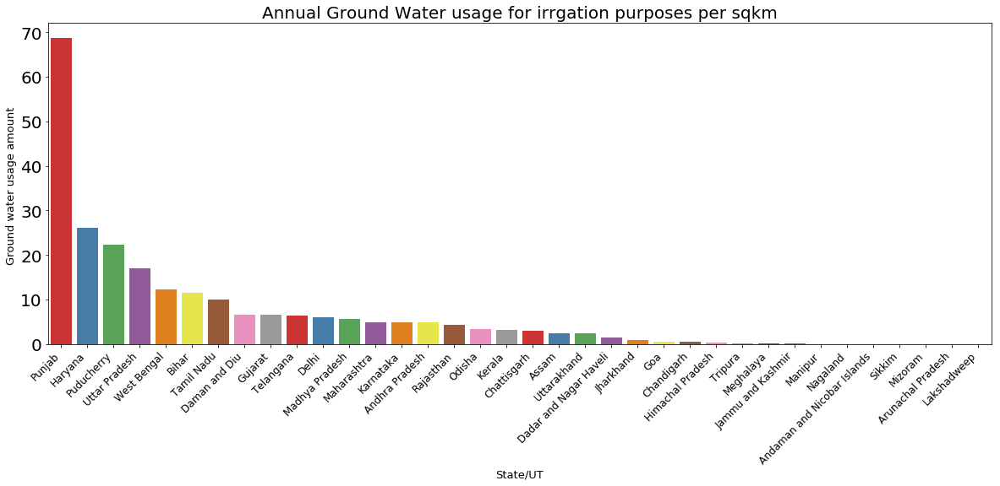

In [133]:
plt.figure(figsize=(20,7))

df_temp2=df_temp2.sort_values(by='irrigation_usage_sqkm',ascending=False)

ch = sns.barplot(df_temp2['Name of State'],df_temp2['irrigation_usage_sqkm'],palette='Set1')

l=ch.get_xticklabels()

ch.set_xticklabels(l,rotation=45, horizontalalignment='right',fontweight='light',fontsize=12)

ch.set_xlabel('State/UT',fontsize=13)
ch.set_ylabel('Ground water usage amount ',fontsize=13)

ch.set_title('Annual Ground Water usage for irrgation purposes per sqkm',fontsize=20)

plt.show()

### Results 

The results are quite good and are matching in par(a little closer) to the analysis given by other organizations and other 
analysis. The clustering of various states was quite convincing from the end results. 

We obtained various results on similar types of states (by kmeans/clustering).
We also obtained top states that are actively participating in Ground water restoration development projects.
Decent results were obtained on individual clustering based on only comsumption methods.

I would say that the results came out better than expected .

### Observations

Clustering while considering all the below parameters, the observations are very clear due to the below reasons

* Extraction, Restoration, Development stages of Ground water.
* This can be understood by 'Seven sisters of India' belonging to almost same cluster
* Andhra Pradesh and Telangana which are recently bifurcated came under the same cluster.

By this we can say that the above clustering worked well

* Ground water levels in few areas are very worse than expected.

* Punjab , Haryana & Punjab stood at the top in ground water consumption for irrigation purposes. 

* Even though 'Uttar Pradesh' has a higher contribution in irrigation, its ground water utilization is less beacause it is located  at the foot of himalayas , so they mainly depend on rain water iself for the irrigation purposes
  
* Punjab has a higher contribution in irriagation in india, still it remains top in our analysis of GW_Consumption per sq.km, by this we can say that punjab has more irrigation land

### Conclusion

Initially when I was thinking of this problem statement, I didn't expect I could do this much out of it, and that too with 
decent outcomes. A lot of observations came out from hard work of around two weeks.

But One thing bothered me was that almost all the states are spending very less money on ground water
restoration projects. If this wasn't taken seriously it could be a serious problem in the near future.

* More projects like ground water restoration, recharge/soak pits, rain water harvesting in each house should be 
  made mandatory atleast for new constructions.
* Campaigns should be organized for improving the awareness and importance of ground water

Finally its a great experience of putting all the skills that I learnt into this great capstone project.Thanks for IBM for
providing this great oppurtunity for us.